In [2]:
import os
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import networkx as nx
from matplotlib.lines import Line2D
import plotly.graph_objects as go

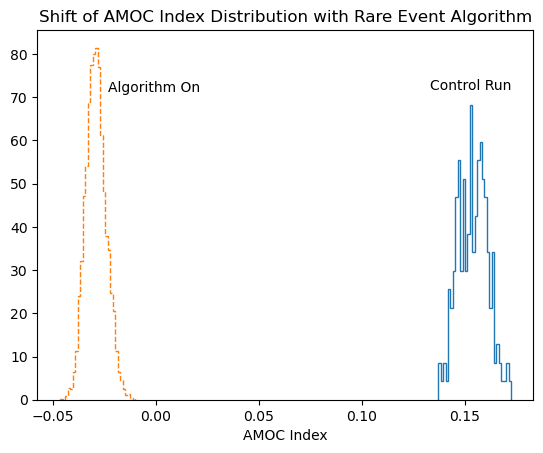

In [33]:
def get_initials():
    
    #control run initial parameterization
    control_run = pd.read_csv('control_run0505.csv')
    #remove transient
    control_dropped = control_run.loc[control_run['t']>=10]
    #access every 5th row (time unit)
    control_5th = control_dropped.iloc[::500]
    control_5th.head()
    cols = ['x','y','z','T', 'S']
    x_list, y_list, z_list, temp_list, salt_list = [control_5th[c].tolist() for c in cols]

    return x_list,y_list,z_list,temp_list,salt_list
    
#plot distribution change between RE algorithm and initial simulation
x_list,y_list,z_list,temp_list,salt_list = get_initials()
amoc_list = []
for temp in range(len(temp_list)):
    amoc_val = temp_list[temp] - salt_list[temp]
    amoc_list.append(amoc_val)

metadata_500 = pd.read_csv('shifted/metadata_20y_200traj_-500k.csv')
metadata_shifted = metadata_500.loc[metadata_500['Run name']>20]
RE_list = metadata_shifted['Last AMOC value'].tolist()

plt.figure()
counts1, bins1, _ = plt.hist(amoc_list, bins=30, density=True, histtype='step', linestyle='-')
mid1 = (bins1[:-1] + bins1[1:]) / 2
peak_x1 = mid1[np.argmax(counts1)]
peak_y1 = max(counts1)
plt.text(peak_x1, peak_y1 + peak_y1*0.05, "Control Run", ha='center')
counts2, bins2, _ = plt.hist(RE_list, bins=30, density=True, histtype='step',linestyle='--')
mid2 = (bins2[:-1] + bins2[1:]) / 2
peak_x2 = mid2[np.argmax(counts2)]
peak_y2 = max(counts2)
plt.text(peak_x2*0.8, peak_y2 + peak_y2*-0.125, "Algorithm On", ha='left')
plt.xlabel("AMOC Index")
plt.title("Shift of AMOC Index Distribution with Rare Event Algorithm")
#plt.show()
plt.savefig("hist_shifted_values.png")

In [3]:
#also control run
control=pd.read_csv('control_run0505.csv')
control_sample = control[:5000]

metadata_10y_20traj_-3045k.csv


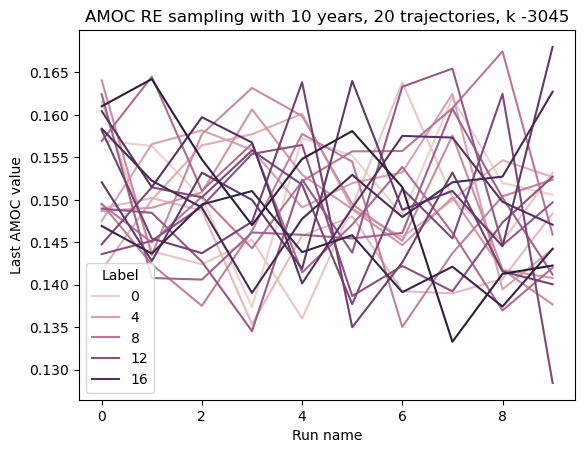

metadata_100y_200traj_169k.csv


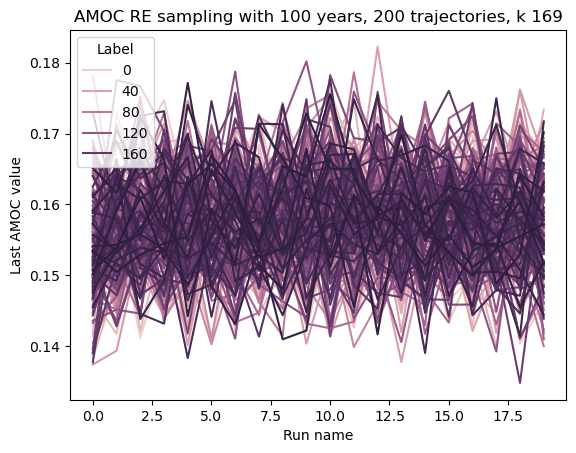

metadata_20y_200traj_-2000k.csv


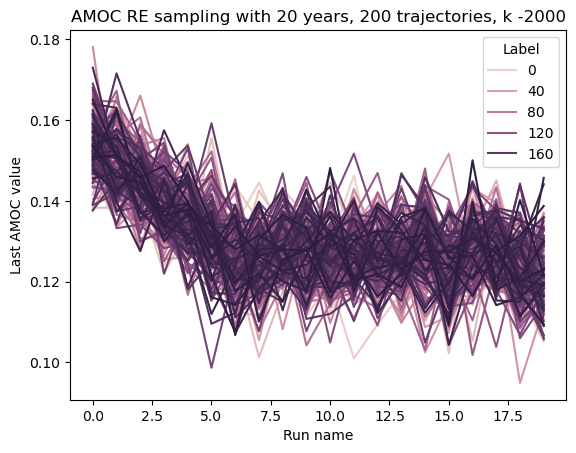

metadata_20y_200traj_-3000k.csv


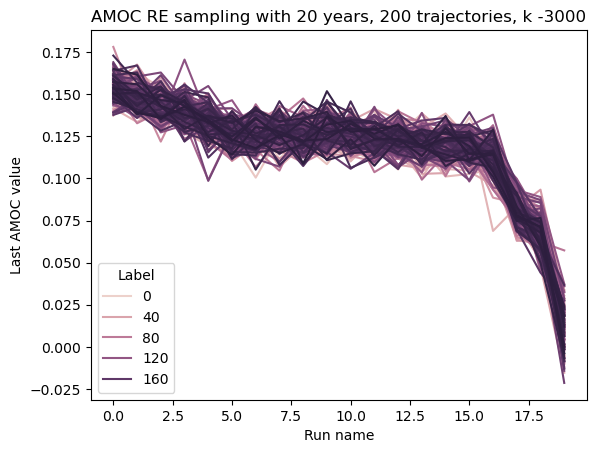

metadata_10y_4traj_-3k.csv


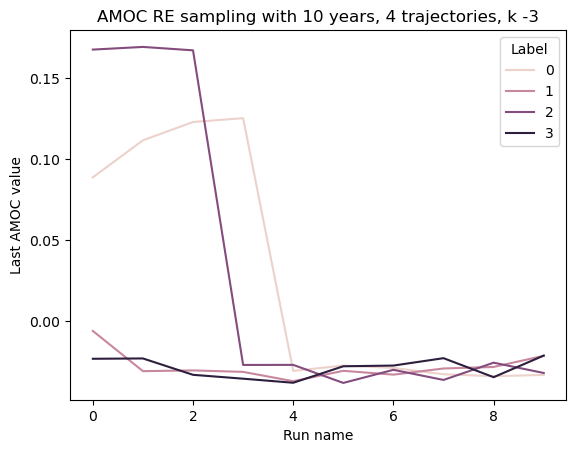

metadata_20y_200traj_-169k.csv


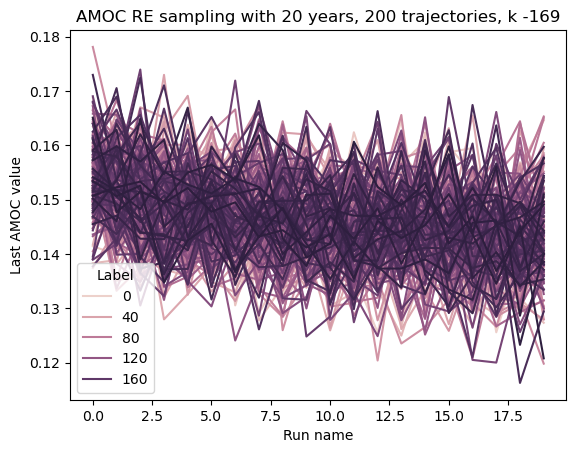

metadata_5y_5traj_-169k.csv


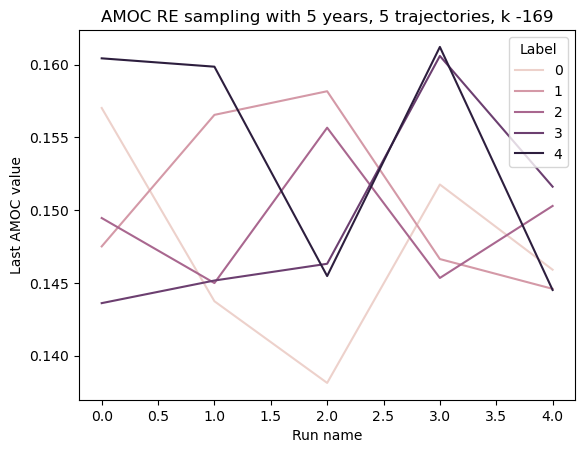

metadata_20y_200traj_1959k.csv


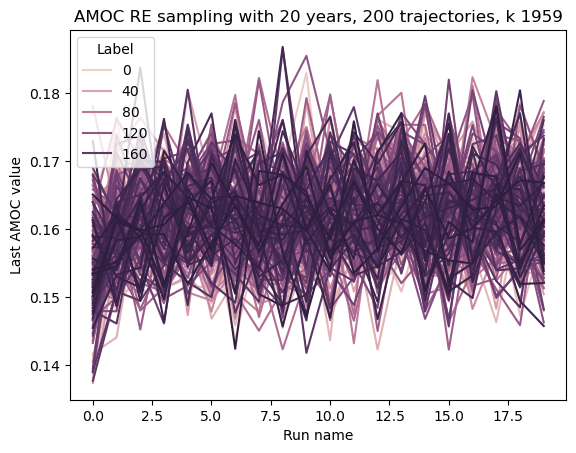

metadata_50y_200traj_-169k.csv


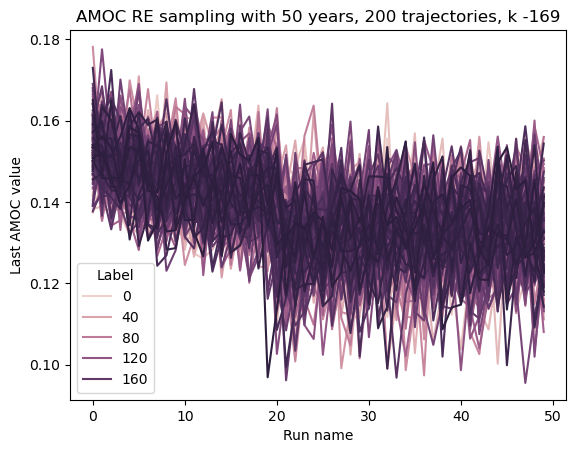

metadata_100y_200traj_1959k.csv


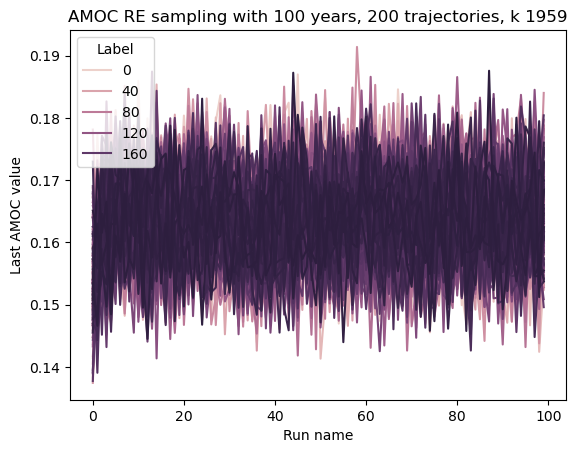

In [100]:
dfs = []
folder_path='Runs/'
for file in os.listdir(folder_path):
    if file.endswith(".csv"):
        print(file)

        # ----- Extract variables from filename -----
        name = file.replace(".csv", "")
        _, years, traj, seed = name.split("_")

        years = int(years.replace("y", ""))
        traj  = int(traj.replace("traj", ""))
        seed  = int(seed.replace("k", ""))

        # ----- Load data -----
        df = pd.read_csv(os.path.join(folder_path, file))
        dfs.append(df)

        # ----- Plot -----
        plt.figure()
        sns.lineplot(data=df, x="Run name", y="Last AMOC value", hue="Label")

        # ----- Dynamic title -----
        plt.title(f"AMOC RE sampling with {years} years, {traj} trajectories, k {seed}")

        plt.show()

salt_35y_200traj_-100000k.csv


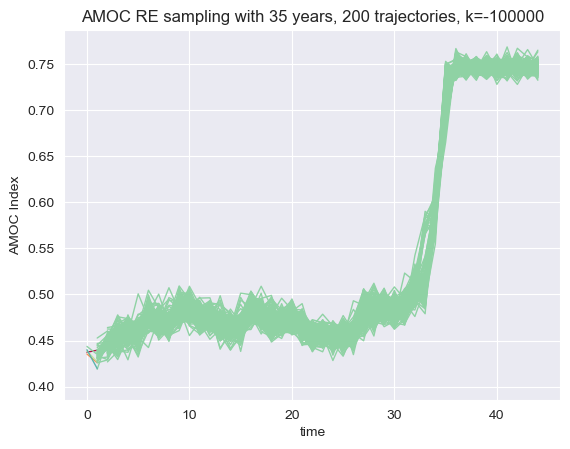

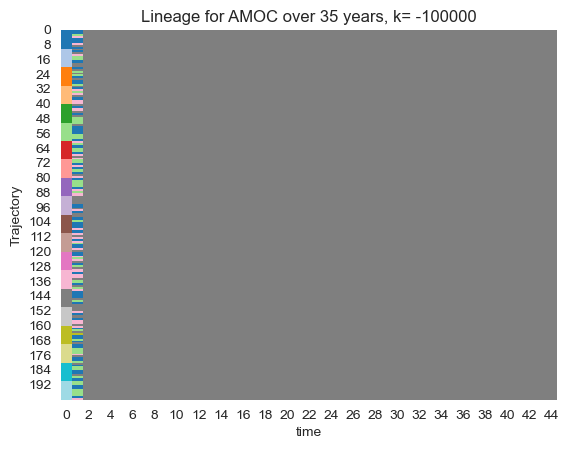

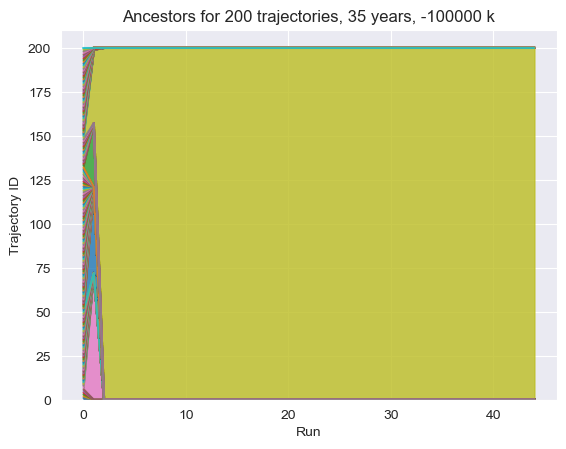

salt_35y_200traj_-10000k.csv


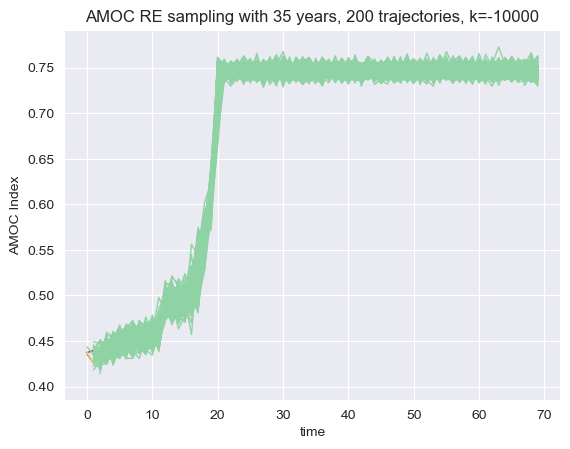

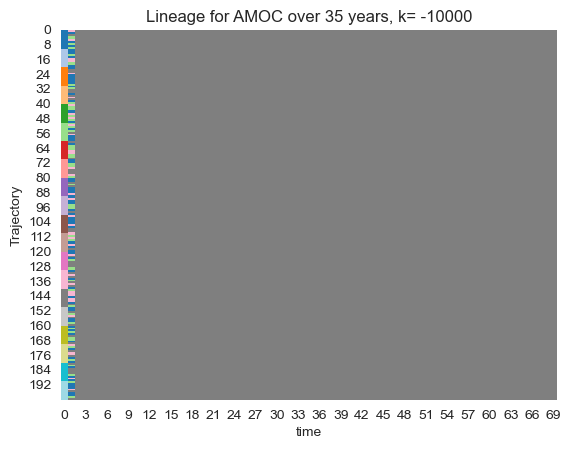

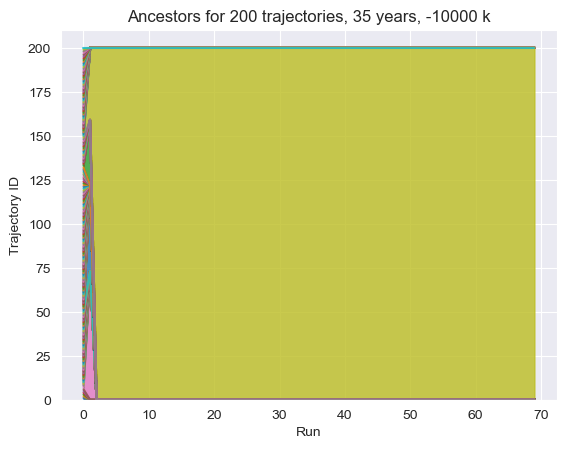

salt_2y_1000traj_-5000k.csv


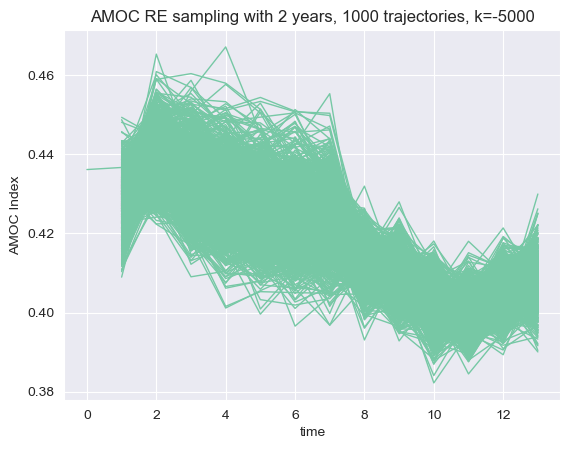

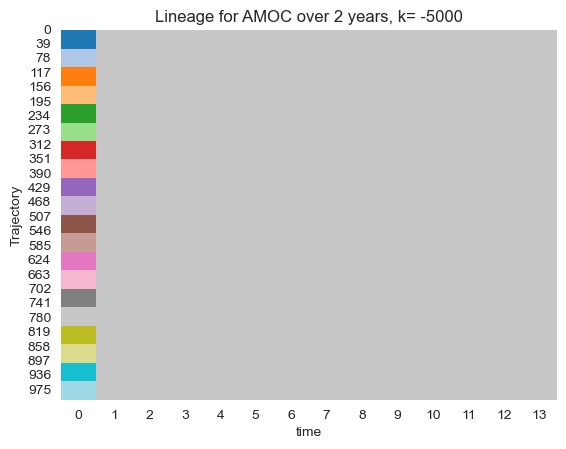

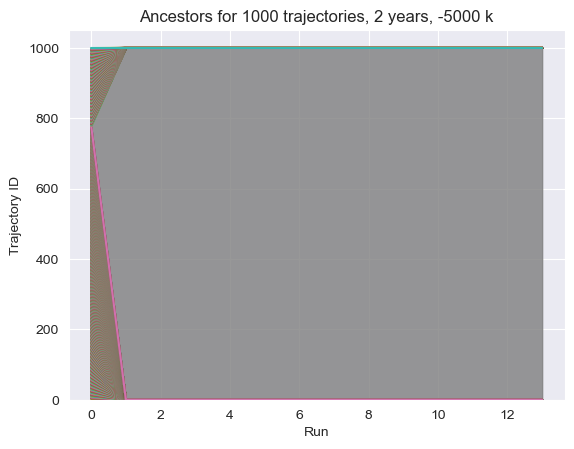

salt_20y_200traj_4000k.csv


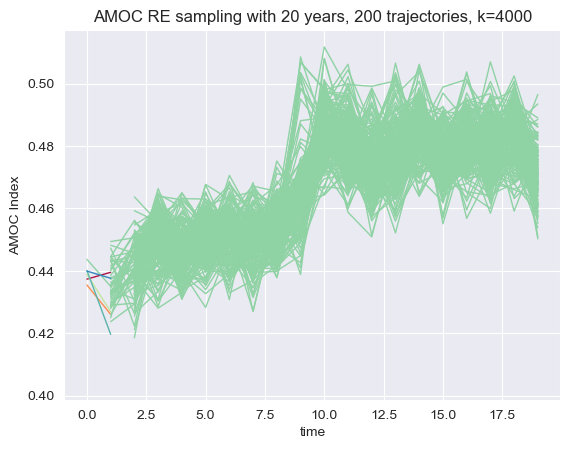

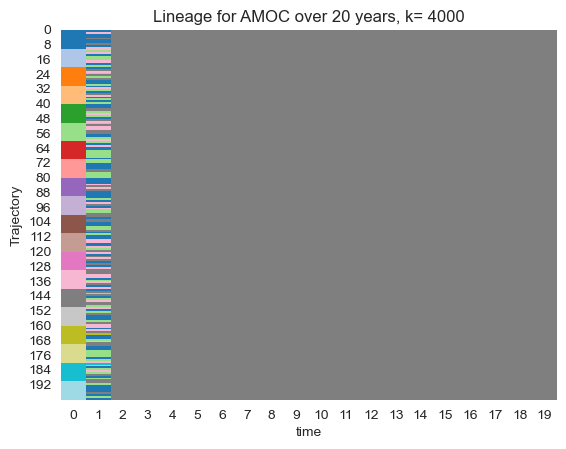

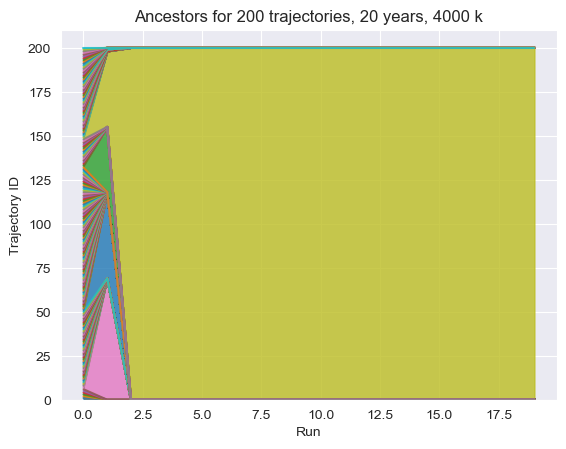

salt_15y_200traj_-5000k.csv


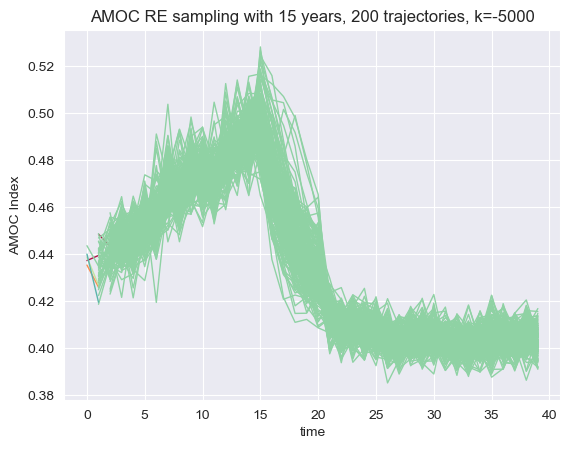

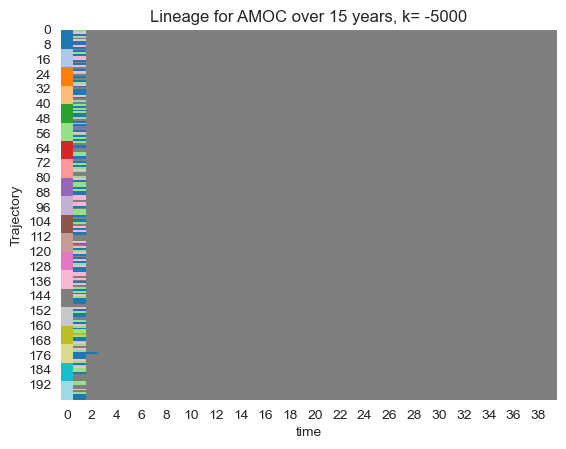

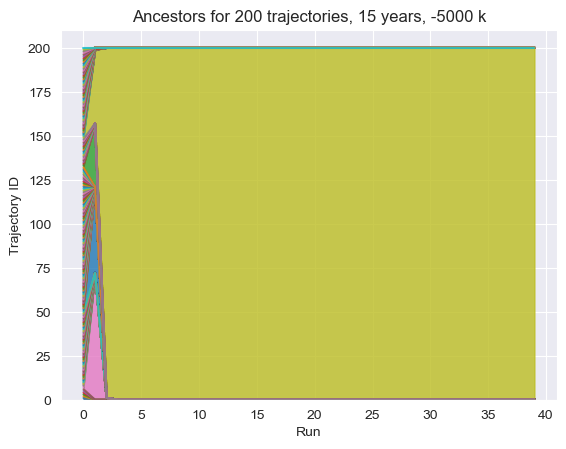

salt_20y_200traj_2967k.csv


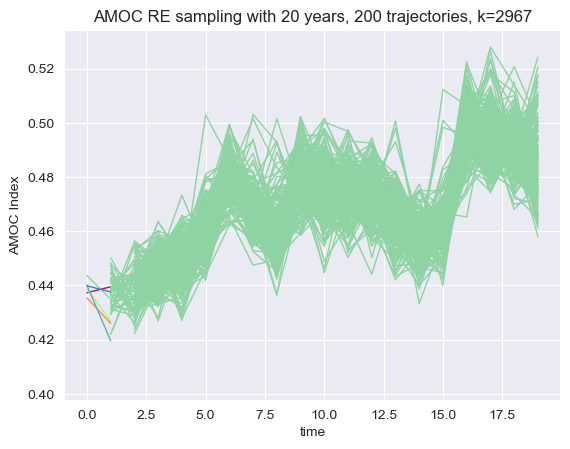

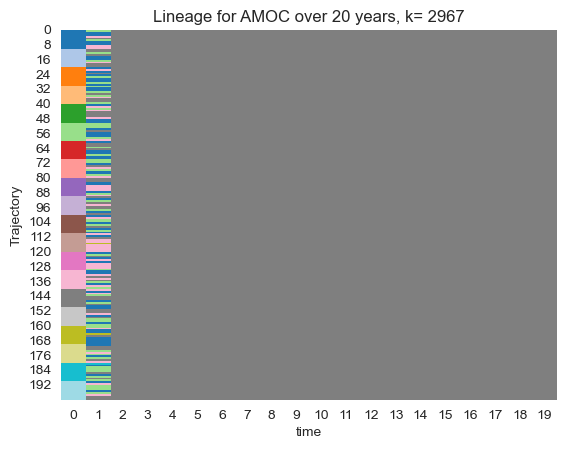

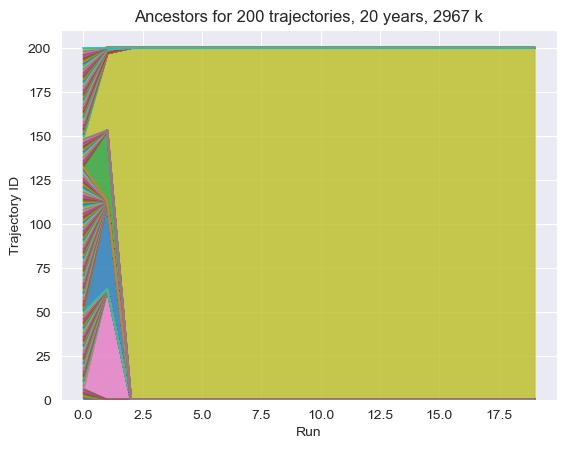

salt_30y_200traj_5000k.csv


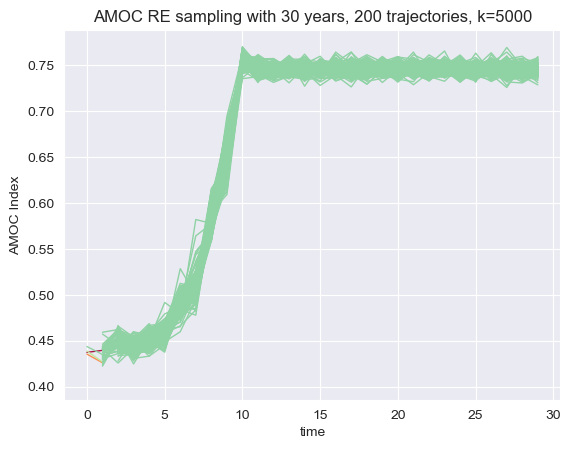

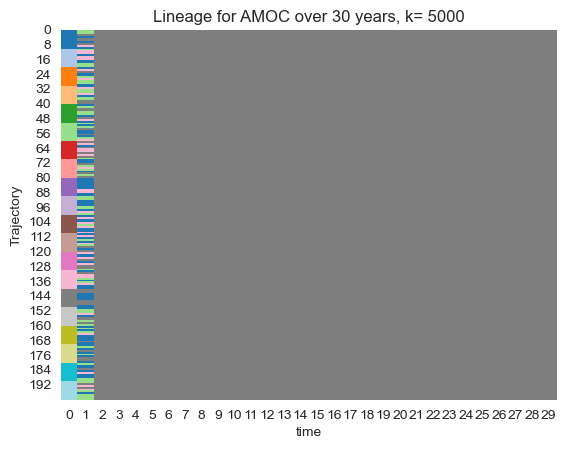

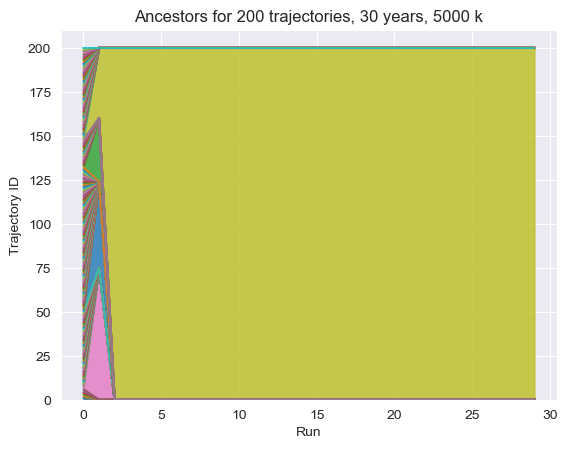

salt_20y_200traj_0k.csv


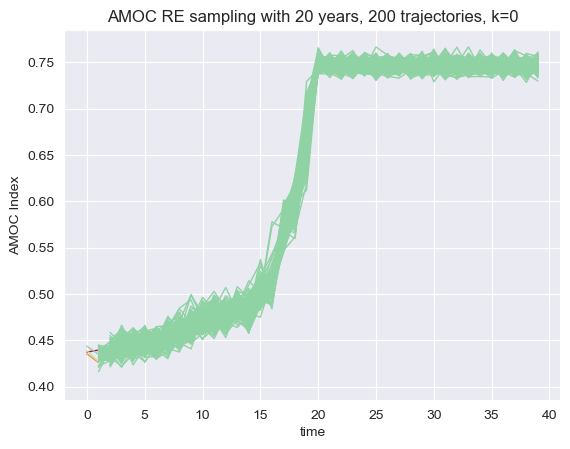

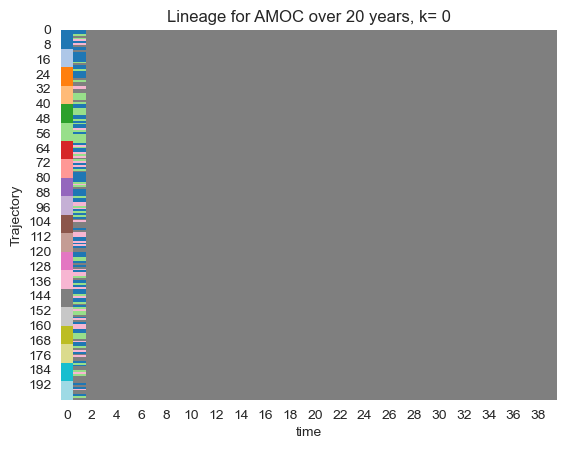

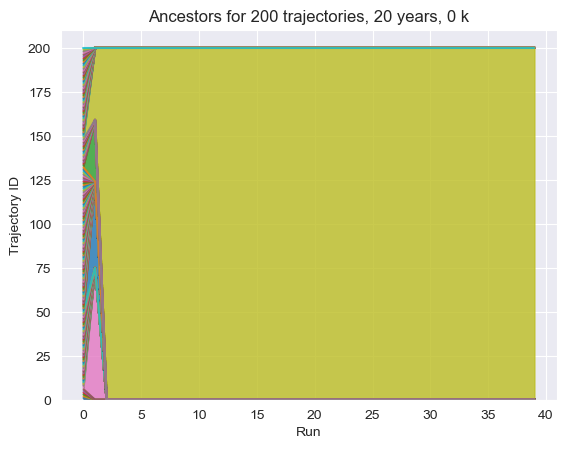

salt_20y_200traj_-5000k.csv


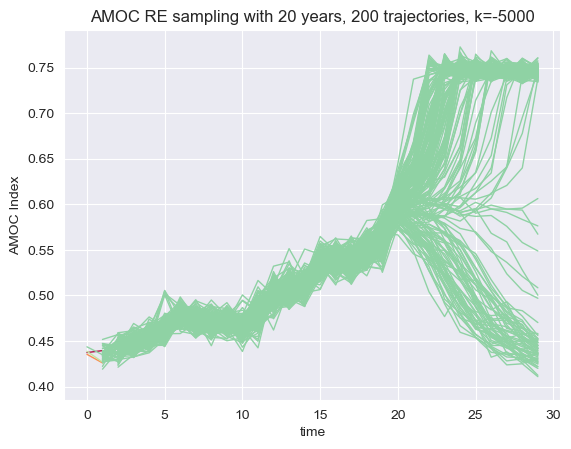

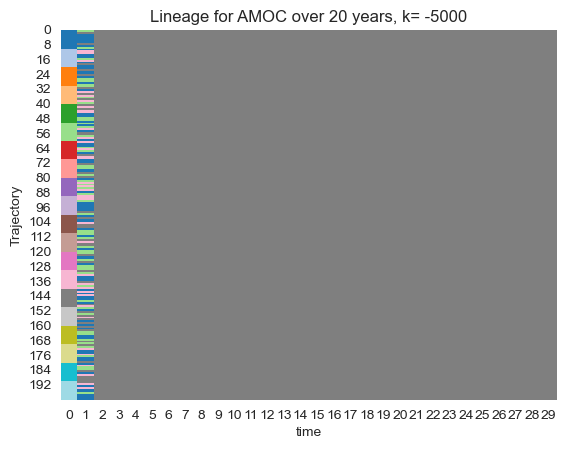

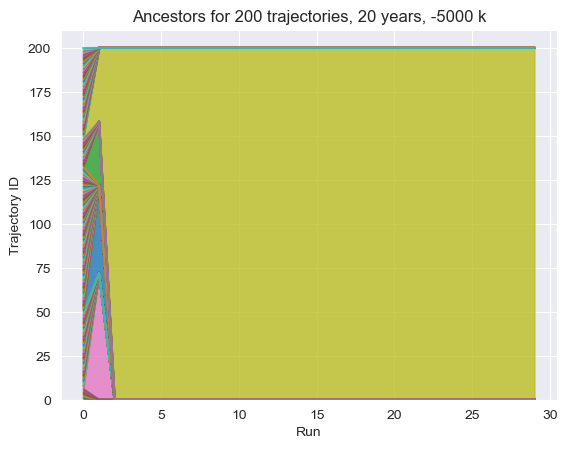

salt_15y_1000traj_-5000k.csv


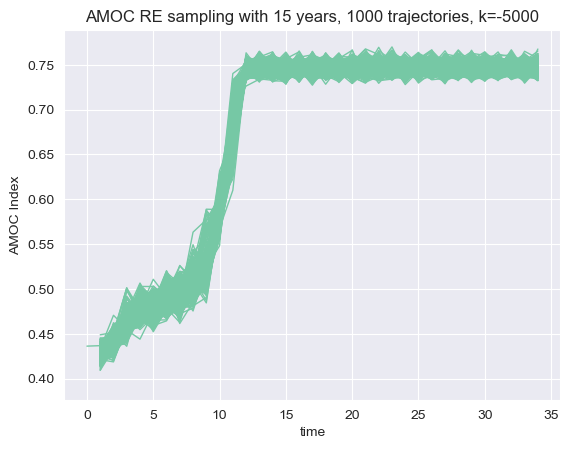

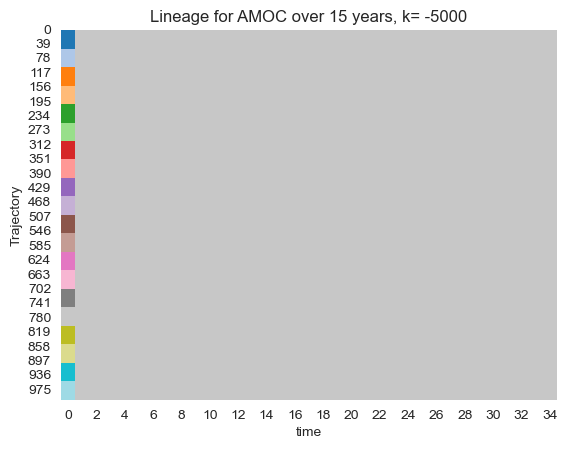

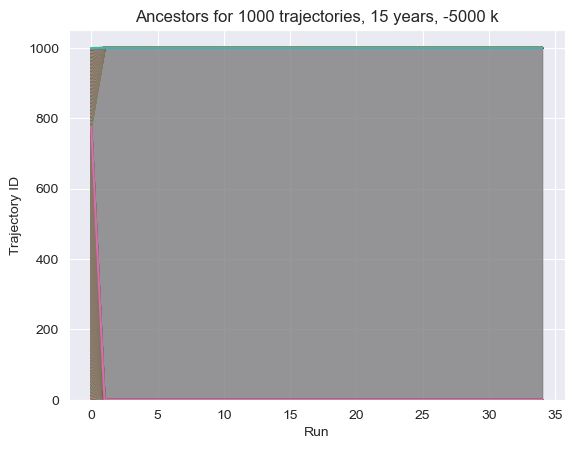

salt_35y_200traj_-20000k.csv


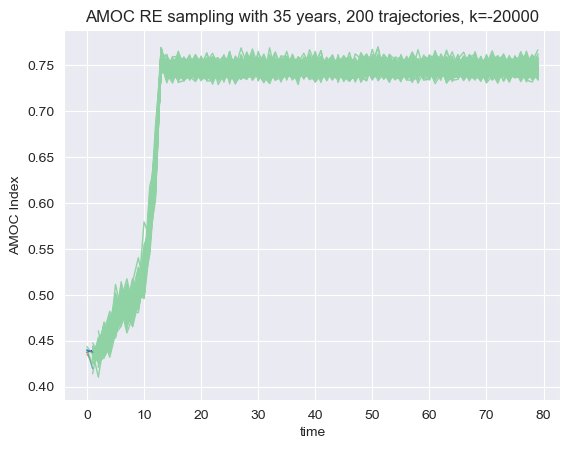

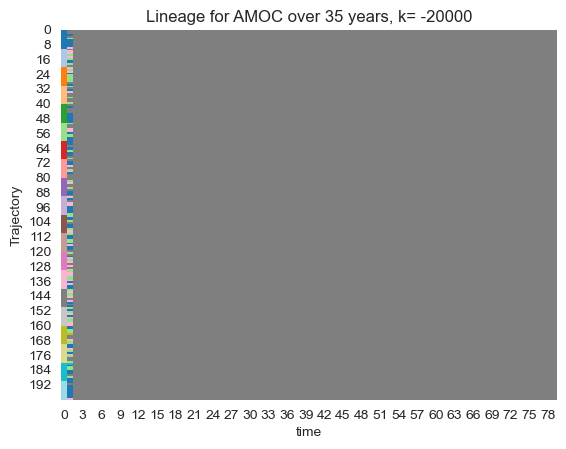

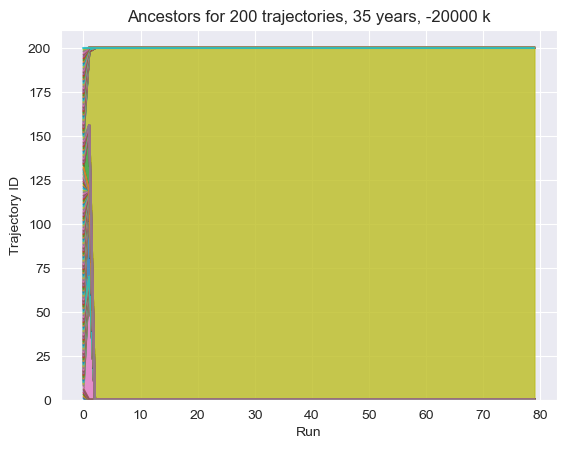

salt_25y_200traj_-5000k.csv


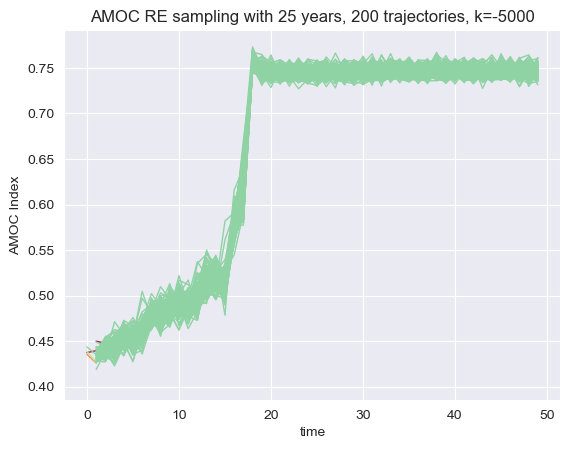

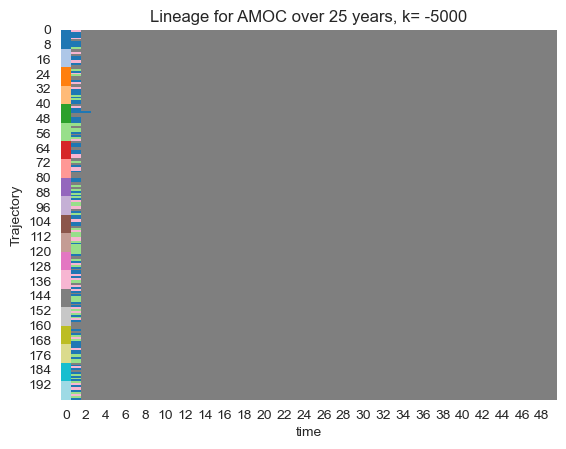

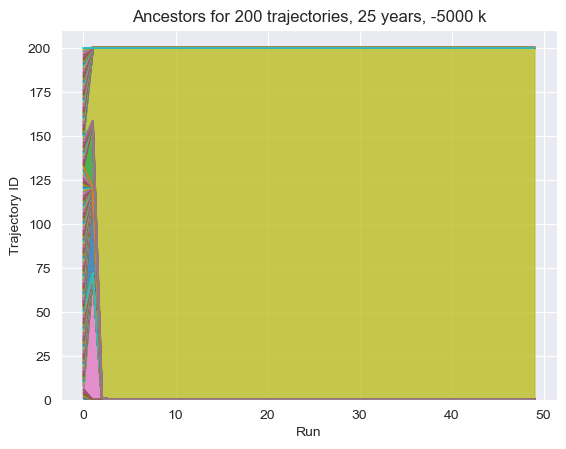

salt_25y_200traj_-10000k.csv


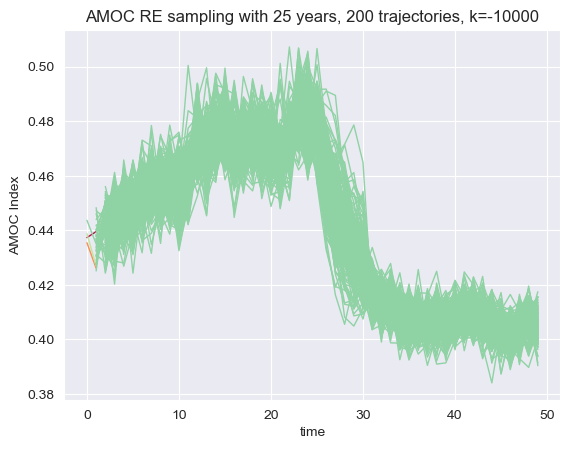

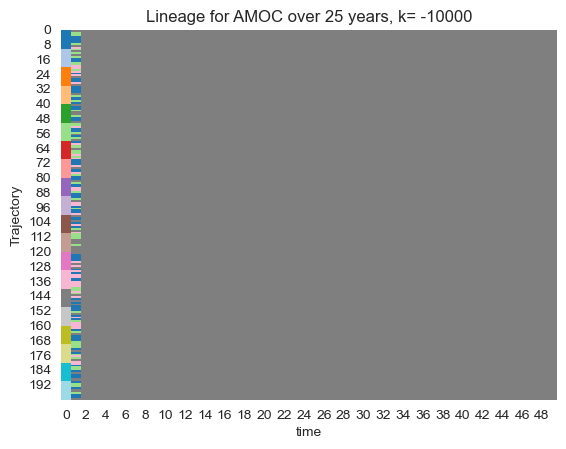

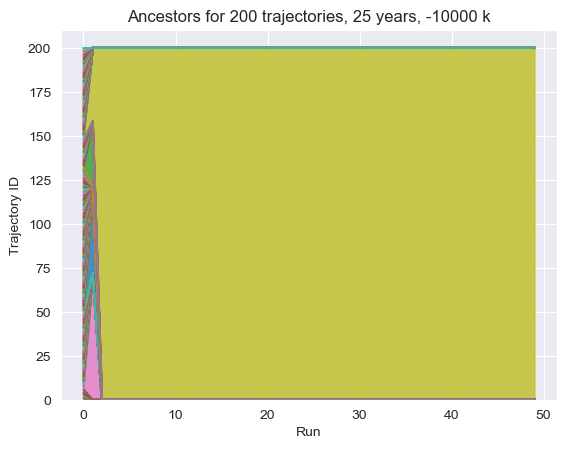

salt_20y_1000traj_0k.csv


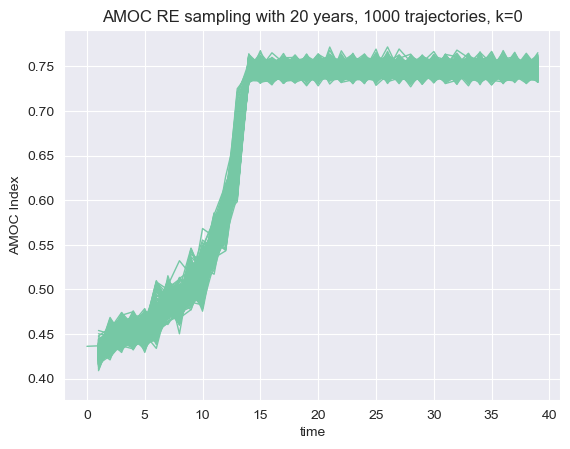

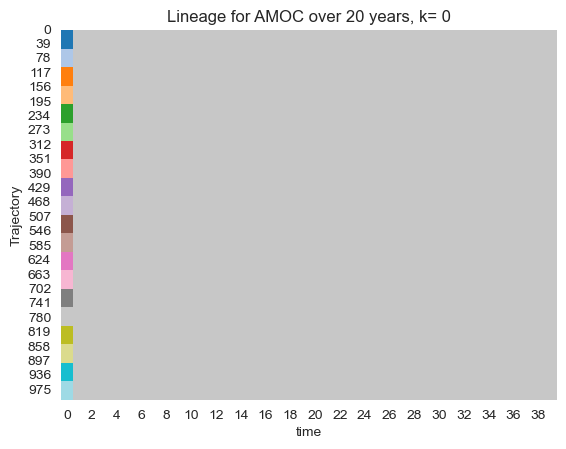

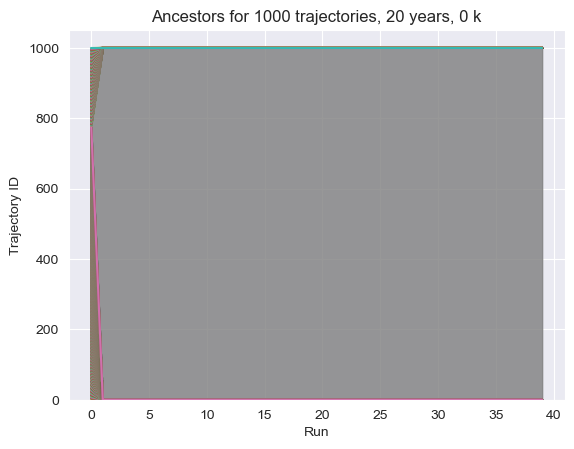

salt_25y_200traj_-6000k.csv


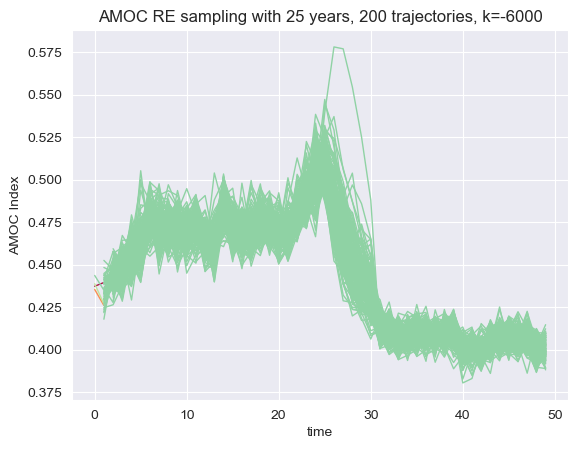

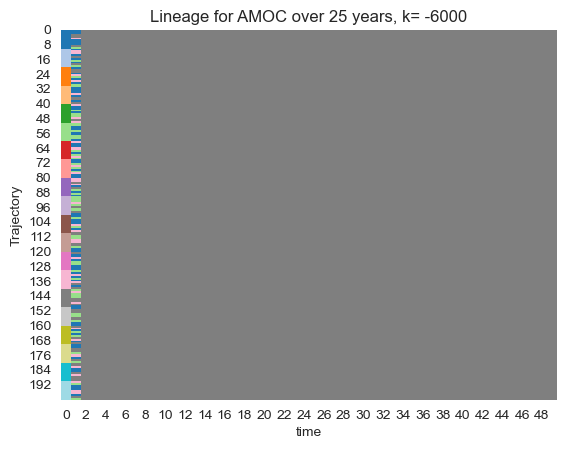

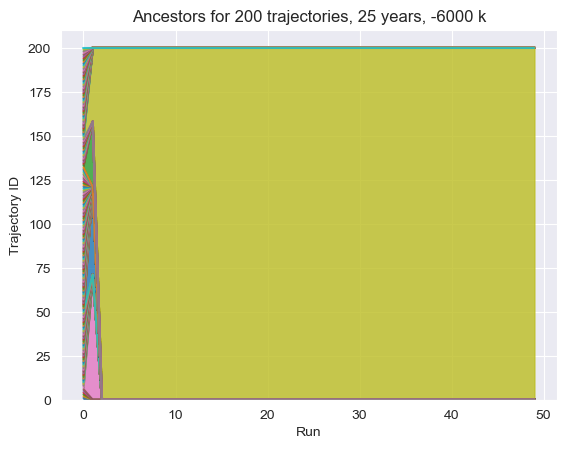

'\n       # plt.show()\n        #plt.close()\n        #plt.savefig(f"lineplot_{years}year_{traj}traj_{seed}k.png")\n\n        plt.figure()\n        #plt.hist(control_sample[\'AMOC\'])\n        plt.hist(df[\'Corresponding S Value\'])\n        plt.title(f"Distribution of AMOC indices during RE Sampling over {years} years")\n        plt.xlabel("Temperature (K)")\n        #plt.show()\n        #plt.close()\n\n'

In [5]:
shifted_dfs = []
ks = []
folder_path='salts/'
for file in os.listdir(folder_path):
    if file.endswith(".csv"):
        print(file)

        #get variables from file name
        name = file.replace(".csv", "")
        _, years, traj, seed = name.split("_")

        years = int(years.replace("y", ""))
        traj  = int(traj.replace("traj", ""))
        seed  = int(seed.replace("k", ""))

        df = pd.read_csv(os.path.join(folder_path, file))
        shifted_dfs.append(df)

        #get ks in list
        ks.append(seed)

        plt.figure()
        #Lineplot
        sns.set_style("darkgrid")
        sns.lineplot(
            data=df,
            x="Run name",
            y="Corresponding S Value",
            hue="Agg Label",
            units="Label",   #forces 200 individual lines
            estimator=None,          #prevents averaging / collapsing
            lw=1,
            palette=sns.color_palette("Spectral", n_colors=df["Label"].nunique()),
            legend=False 
        )
        plt.title(f"AMOC RE sampling with {years} years, {traj} trajectories, k={seed}")
        plt.xlabel("time")
        plt.ylabel("AMOC Index")

        
       # plt.savefig(f"amoc_lineplot_{years}year_{traj}traj_{seed}k.png")
        #Barcode plot
        pivot = df.pivot(index='Label', columns='Run name', values='Agg Label')

        plt.figure()
        sns.heatmap(pivot, cmap="tab20", cbar=False)
        plt.xlabel("time")
        plt.ylabel("Trajectory")
        plt.title(f"Lineage for AMOC over {years} years, k= {seed}")
        plt.show()
        plt.close()
        #plt.savefig(f"amoc_barcode_{years}year_{traj}traj_{seed}k.png")

        #muller plot
        counts = df.groupby(['Run name', 'Agg Label']).size().reset_index(name='count')
        pivot = counts.pivot(index='Run name', columns='Agg Label', values='count').fillna(0)
        
        pivot.plot.area(alpha=0.8)
        plt.legend([],[], frameon=False)
        plt.title(f"Ancestors for {traj} trajectories, {years} years, {seed} k")
        plt.xlabel("Run")
        plt.ylabel("Trajectory ID")
        plt.show()

        plt.close()
'''
       # plt.show()
        #plt.close()
        #plt.savefig(f"lineplot_{years}year_{traj}traj_{seed}k.png")

        plt.figure()
        #plt.hist(control_sample['AMOC'])
        plt.hist(df['Corresponding S Value'])
        plt.title(f"Distribution of AMOC indices during RE Sampling over {years} years")
        plt.xlabel("Temperature (K)")
        #plt.show()
        #plt.close()

'''

In [154]:
#percent of killed trajs over time
#count 1s in Killed? in each Run name (group by, sum)
for df in range(len(shifted_dfs)):
    num_killed = shifted_dfs[df].groupby('Run name')['Killed?'].sum()
    print("Df ",ks[df],num_killed)

Df  -2000 Run name
0     192.0
1     194.0
2     186.0
3     196.0
4     199.0
5     197.0
6     198.0
7     198.0
8     197.0
9     199.0
10    193.0
11    157.0
12    170.0
13    160.0
14    161.0
15    190.0
16    172.0
17    170.0
18    171.0
19    172.0
Name: Killed?, dtype: float64
Df  -100 Run name
0     51.0
1     36.0
2     53.0
3     42.0
4     43.0
5     56.0
6     49.0
7     46.0
8     39.0
9     43.0
10    46.0
11    48.0
12    55.0
13    63.0
14    62.0
15    57.0
16    53.0
17    58.0
18    68.0
19    58.0
Name: Killed?, dtype: float64
Df  -3 Run name
0     2.0
1     3.0
2     1.0
3     1.0
4     3.0
5     2.0
6     1.0
7     5.0
8     1.0
9     2.0
10    2.0
11    1.0
12    0.0
13    1.0
14    2.0
15    1.0
16    2.0
17    4.0
18    1.0
19    1.0
20    1.0
21    2.0
22    1.0
23    1.0
24    2.0
25    1.0
26    1.0
27    1.0
28    2.0
29    1.0
Name: Killed?, dtype: float64
Df  -3000 Run name
0     194.0
1     193.0
2     197.0
3     198.0
4     199.0
5     192.0
6     

In [212]:
salt_trans = pd.read_csv('salts/salt_20y_1000traj_0k.csv')
amoc_trans = pd.read_csv('shifted/metadata_20y_1000traj_0k.csv')

In [279]:
#show variance of each variable over time
real_var_labels = ['Salinity','Temperature','Atmosphere x','Atmosphere y','Atmosphere z']
df_label = ['Salinity RE Forcing','AMOC RE Forcing']
def variance_over_time(df,var,real_var,df_label):
    salt_var_salt = df.groupby('Run name')[var].var()
    plt.figure()
    plt.plot(salt_var_salt)
    plt.xlabel('time')
    plt.ylabel('Variance')
    plt.title(f"{real_var} Variance Over Time in {df_label}")
    plt.savefig(f"variance_{df_label}_{real_var}.png")
    #plt.show()
    #plt.close()

vars = ['Corresponding S Value','Corresponding T value','Corresponding x value','Corresponding y value','Corresponding z value']
dfs = [salt_trans,amoc_trans]

In [256]:
print(len(salt_trans['Corresponding S Value'].tolist()))
averaged = salt_trans.groupby('Run name')['Corresponding S Value'].mean()
print(len(averaged))
list=averaged.tolist()
amoc_list = np.array(list)
print(len(amoc_list))
print(amoc_list)

40000
40
40
[0.42160319 0.42864891 0.44310259 0.4519846  0.45423062 0.45388328
 0.46322345 0.4884658  0.48350245 0.50351153 0.51831403 0.55208187
 0.58189723 0.64595611 0.74621757 0.74571846 0.74519902 0.74539848
 0.74556698 0.74523494 0.74507137 0.7466617  0.74598948 0.74591362
 0.74606064 0.74636267 0.7460934  0.74607592 0.74624264 0.7462078
 0.74642409 0.74588516 0.74608583 0.74625233 0.74627346 0.74637413
 0.74631017 0.74623902 0.74585387 0.74606825]


In [277]:
def auto_corr(df,column,df_label,var_label):
    averaged = df.groupby('Run name')[column].mean()
    list=averaged.tolist()
    amoc_list = np.array(list)
    print(len(amoc_list))
    num_slices = 1
    slice_length = len(amoc_list) // num_slices
    
    #Split series into slices
    slices = np.array_split(amoc_list, num_slices)
    
    #Initialize array to store ACF for each slice
    expectations = np.zeros((num_slices, slice_length))
    
    for slice_num, s in enumerate(slices):
        s = np.array(s)
        mean_s = np.mean(s)
        var_s = np.var(s)
    
        #Compute autocovariance for each lag
        for lag in range(slice_length):
            #Take all overlapping pairs at this lag, s[:len(s)-lag] -> all except last values, (s[lag:]) -> all except first vals
            products = (s[:len(s)-lag] - mean_s) * (s[lag:] - mean_s)
            expectations[slice_num, lag] = np.mean(products) / var_s 
    
    #Average ACF across slices
    ACF = np.mean(expectations, axis=0)
    
    #plot autocorrelation function
    title_var = slice_length/1
    plt.figure()
    plt.plot(ACF)
    plt.title(f"Average Auto-Correlation of {var_label} in {df_label} in {title_var} Years")
    plt.xlabel('timepoint')
    plt.ylabel('Auto-correlation')
    plt.savefig(f"acfunc_{df_label}_{var_label}.png")

40
40
40
40
40
40
40
40
40
40


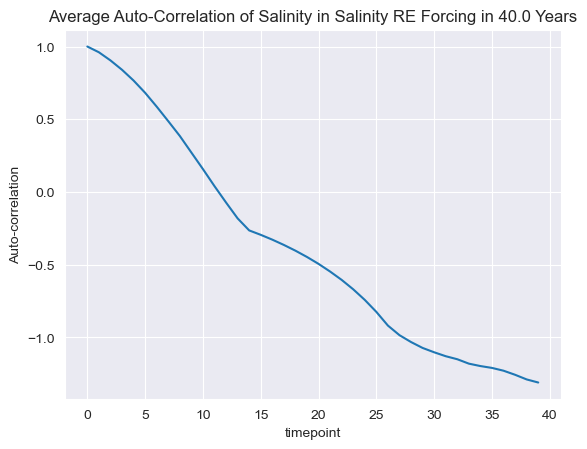

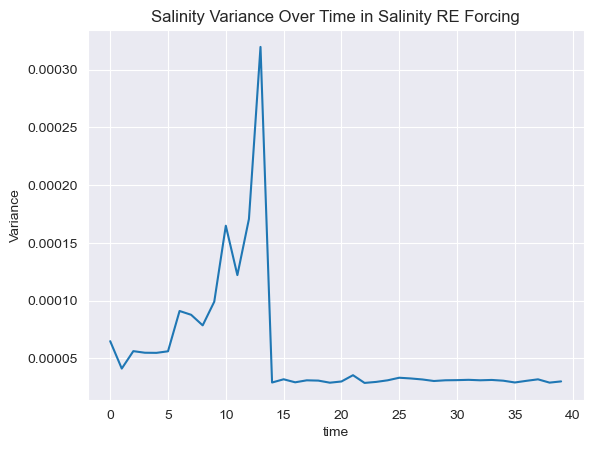

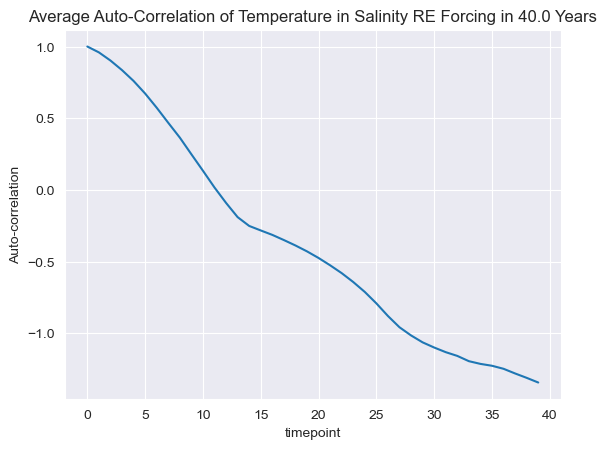

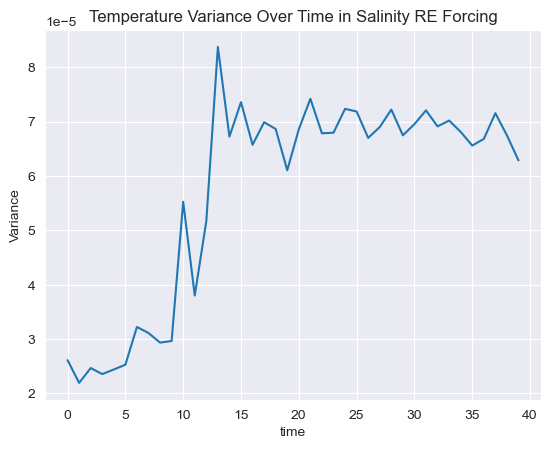

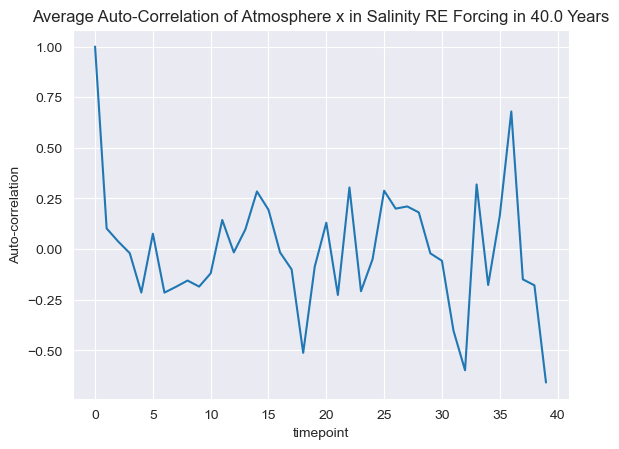

...

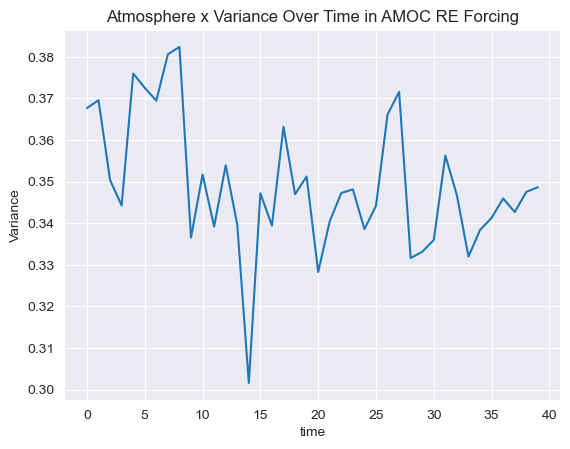

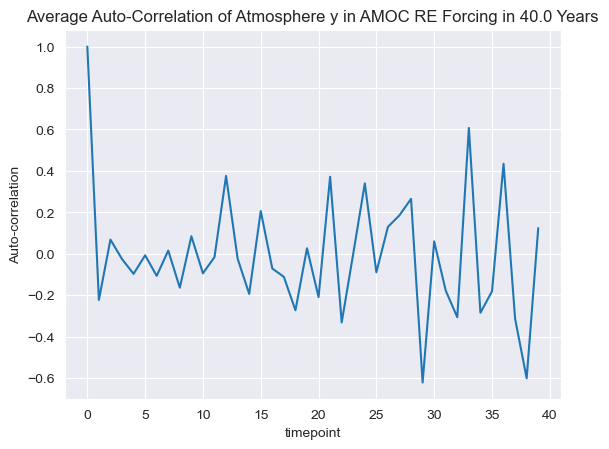

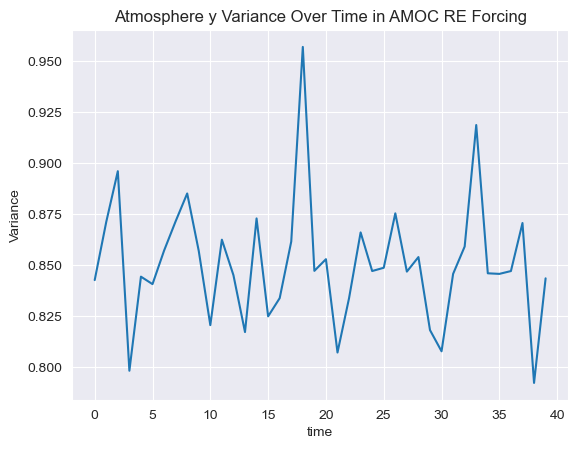

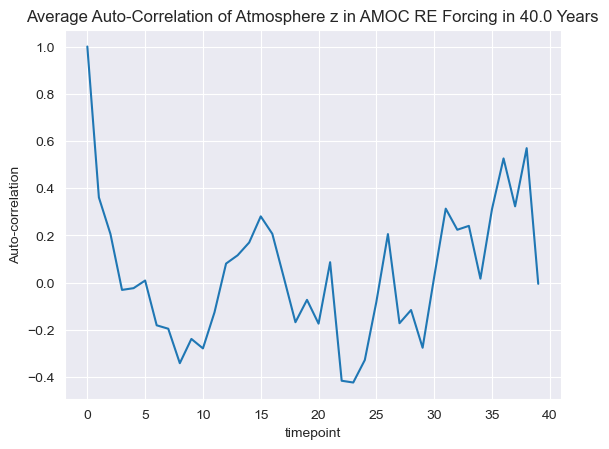

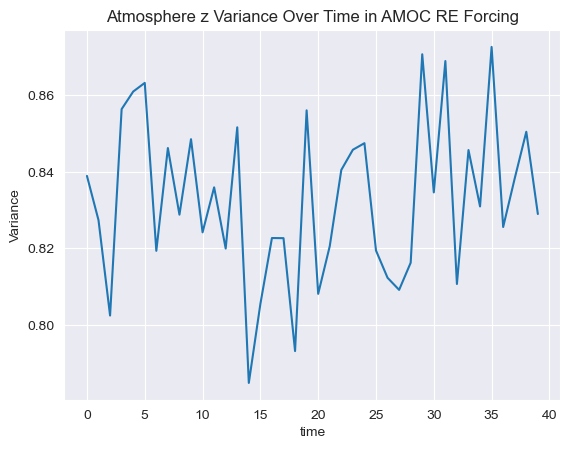

In [280]:
for df in range(len(dfs)):
    for var in range(len(vars)):
        auto_corr(dfs[df],vars[var],df_label[df],real_var_labels[var])
        variance_over_time(dfs[df],vars[var],real_var_labels[var],df_label[df])

#email F about going through the things on PLASIM, set a time for Friday
#on Thursday can continue trying my best basically - at least get a working script for the base PLASIM, figure out how to stop the 
#model

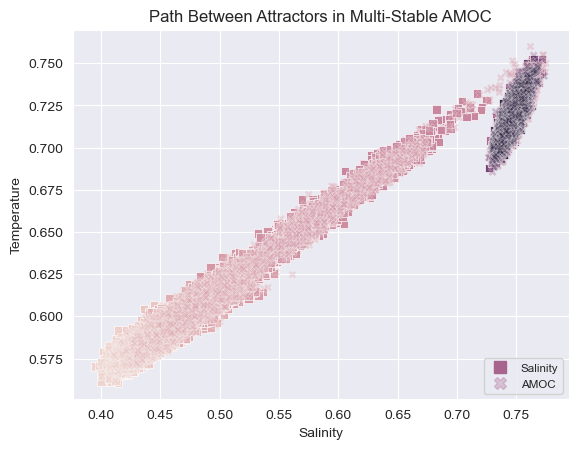

In [188]:
#make 2D and 3D scatter plots to show AMOC on/off and salinity-driven transitions in one plot
plt.figure()

ax = plt.gca()
sns.scatterplot(data=salt_trans,x='Corresponding S Value',y='Corresponding T value',style=None,marker='s',
                hue='Run name',legend=False,ax=ax)
sns.scatterplot(data=amoc_trans,x='Corresponding S Value',y='Corresponding T value',style=None,marker='X',
                hue='Run name',alpha=0.3,ax=ax)
plt.title('Path Between Attractors in Multi-Stable AMOC')
plt.xlabel('Salinity')
plt.ylabel('Temperature')

#for salt
salinity_color = ax.collections[0].get_facecolor()[len(salt_trans)//2]
#for amoc
amoc_color = ax.collections[1].get_facecolor()[len(amoc_trans)//2]

#legend
legend_elements = [
    Line2D([0], [0], marker='s', linestyle='None',
           label='Salinity', markersize=8,
            markerfacecolor=salinity_color,
            markeredgecolor=salinity_color,),
    Line2D([0], [0], marker='X', linestyle='None',
           label='AMOC', markersize=8,
            markerfacecolor=amoc_color,
            markeredgecolor=amoc_color,)
]

plt.legend(
    handles=legend_elements,
    loc=4,
    fontsize='small',
    fancybox=True
)
plt.savefig("transition_2D_time.png")
#plt.show()
#plt.close()

In [190]:
#plot the same thing but instead use cutoffs of attractors
#approx cutoff filters
def make_state_labels(df,low_value,high_value):
    amoc_list = df['Run name'].tolist()
    state_label = []
    for salt in salt_list:
        if salt<=low_value:
            state_label.append('AMOC on')
        elif salt>=high_value:
            state_label.append('AMOC off')
        else:
            state_label.append('transition path')
            
    return state_label

In [191]:
amoc_labels = make_state_labels(amoc_trans,9,11)
salt_labels = make_state_labels(salt_trans,12,15)

In [192]:
amoc_trans['State Label'] = amoc_labels
salt_trans['State Label'] = salt_labels

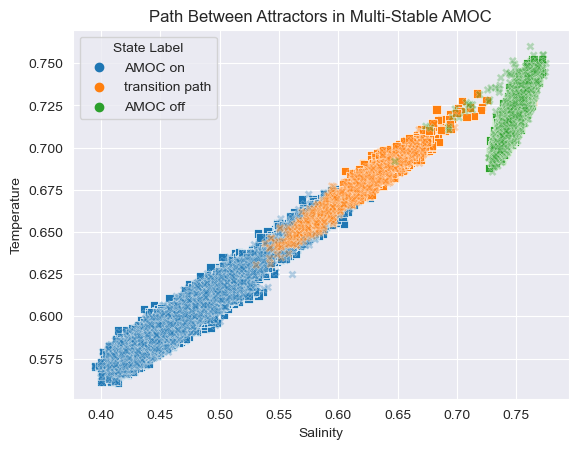

In [193]:
plt.figure()

ax = plt.gca()
sns.scatterplot(data=salt_trans,x='Corresponding S Value',y='Corresponding T value',style=None,marker='s',
                hue='State Label',legend=False,ax=ax)
sns.scatterplot(data=amoc_trans,x='Corresponding S Value',y='Corresponding T value',style=None,marker='X',
                hue='State Label',alpha=0.3,ax=ax)
plt.title('Path Between Attractors in Multi-Stable AMOC')
plt.xlabel('Salinity')
plt.ylabel('Temperature')

plt.savefig("transition_2D_state.png")
#plt.show()
#plt.close()

In [194]:
#add atmospheric variables
salt_trans['Atmosphere'] = (salt_trans['Corresponding x value']**2 + salt_trans['Corresponding y value']**2 + 
                            salt_trans['Corresponding z value']**2)/2

amoc_trans['Atmosphere'] = (amoc_trans['Corresponding x value']**2 + amoc_trans['Corresponding y value']**2 + 
                            amoc_trans['Corresponding z value']**2)/2

In [170]:
amoc_trans.head()

,"Initial S,T",Last AMOC value,Corresponding T value,Corresponding S Value,Corresponding x value,Corresponding y value,Corresponding z value,Label,Exponential,Weight,...,Agg Label,Initial Temperatures Next Block,Initial Salinities Next Block,Initial x Next Block,Initial y Next Block,Initial z Next Block,Run name,k,State Label,Atmosphere
0,"1.985022297163183,1.5065201856165769,0.2682717...",0.155734,0.575225,0.419490,0.815745,-0.155930,-0.799435,0,0.332269,0.010232,...,0,0.579959,0.434718,1.862153,-1.194222,0.157274,0,-500,AMOC on,0.664425
1,"0.0400851697060662,1.2930794810649289,-0.38254...",0.158402,0.572626,0.414224,0.536665,-1.042627,0.547800,1,0.056433,0.001738,...,1,0.583115,0.437075,1.686235,-1.305327,0.334995,0,-500,AMOC on,0.837582
2,"0.3632528642168734,1.0638285263561396,0.725205...",0.142406,0.574249,0.431843,1.318320,-2.004575,-0.269280,2,14.029054,0.432002,...,2,0.582611,0.433413,0.662059,0.921572,-0.817036,0,-500,AMOC on,2.914400
3,"0.7775721571280785,-1.009967930444695,-0.40149...",0.152897,0.579650,0.426753,1.856602,-0.452752,1.125291,3,5.624339,0.173192,...,3,0.585171,0.439800,0.951692,-1.169494,-0.335869,0,-500,AMOC on,2.459118
4,"1.3700137483706651,-0.0580615695215638,-0.7629...",0.149559,0.572503,0.422944,0.663068,-0.102346,1.104759,4,0.509973,0.015704,...,4,0.583146,0.435891,1.554794,0.330176,-0.185701,0,-500,AMOC on,0.835314


Text(0.5, 0, 'Atmosphere')

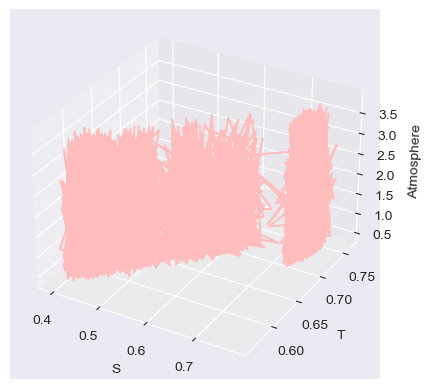

In [209]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

#ax.scatter(salt_trans['Corresponding S Value'], salt_trans['Corresponding T value'], salt_trans['Atmosphere'], c='#7abe80', s=40)
ax.scatter(amoc_trans['Corresponding S Value'], amoc_trans['Corresponding T value'], amoc_trans['Atmosphere'], c='#ffbdbd', s=40)
#ax.scatter(salt_trans['Corresponding S Value'], amoc_trans['Corresponding T value'], amoc_trans['Atmosphere'], c='#7abe80', s=40,alpha=0.3)

ax.set_xlabel('S')
ax.set_ylabel('T')
ax.set_zlabel('Atmosphere')

#plt.show()

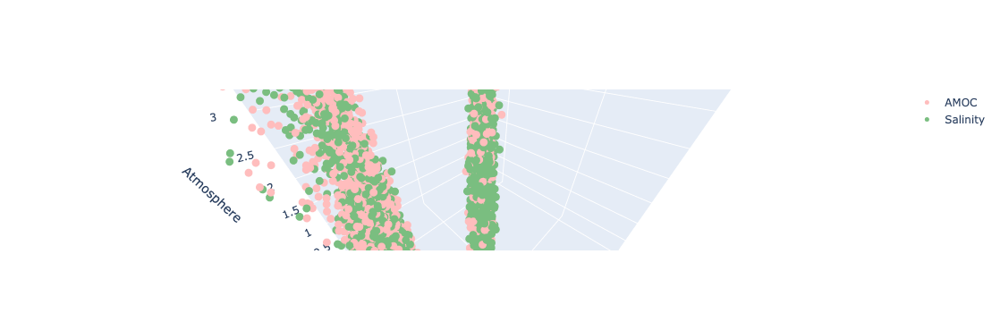

In [187]:


#AMOC
trace_amoc = go.Scatter3d(
    x=amoc_trans['Corresponding S Value'],
    y=amoc_trans['Corresponding T value'],
    z=amoc_trans['Atmosphere'],
    mode='markers',
    marker=dict(
        size=5,
        color='#ffbdbd',
        opacity=1.0
    ),
    name='AMOC'
)

#salt
trace_salt = go.Scatter3d(
    x=salt_trans['Corresponding S Value'],
    y=salt_trans['Corresponding T value'],
    z=salt_trans['Atmosphere'],
    mode='markers',
    marker=dict(
        size=5,
        color='#7abe80',
    ),
    name='Salinity'
)

fig = go.Figure(data=[trace_amoc, trace_salt])
fig.update_layout(
    scene=dict(
        xaxis_title='S',
        yaxis_title='T',
        zaxis_title='Atmosphere'
    ),
    legend=dict(font=dict(size=12))
)


fig.show()


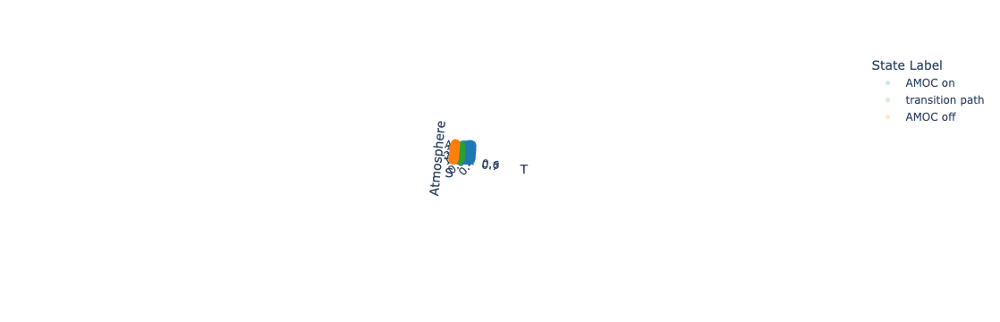

In [183]:

state_palette = {
    'AMOC on': '#1f77b4',      
    'AMOC off': '#ff7f0e',       
    'transition path': '#2ca02c'  
}
#mapping
amoc_trans['color'] = amoc_trans['State Label'].map(state_palette)
salt_trans['color'] = salt_trans['State Label'].map(state_palette)

fig = px.scatter_3d(
    amoc_trans,
    x='Corresponding S Value',
    y='Corresponding T value',
    z='Atmosphere',
    color='State Label',       
    color_discrete_map=state_palette,
    size_max=3
)

fig = px.scatter_3d(
    salt_trans,
    x='Corresponding S Value',
    y='Corresponding T value',
    z='Atmosphere',
    color='State Label',        
    color_discrete_map=state_palette,
    size_max=3,
)

fig.update_traces(marker=dict(size=5, opacity=0.2))

fig.update_layout(
    scene=dict(
        xaxis_title='S',
        yaxis_title='T',
        zaxis_title='Atmosphere'
    )
)

fig.show()

In [309]:
#scratch paper basically because I'm trying to figure out something else :(
#figure out the size of the ensemble based on the control run (this is already done and works)
#split the ensemble into a reasonable number that actually works with the number of cores we use
#for each batch of ensemble members,
#simulate a trajectory for so many years
#basically do that until there's no more
import math
ensemble_size=100
#for each trajectory in ensemble size, will be running a simulation of 10 years
#can't run them all at once, so need to split it into number of cores
number_cores_avail=4
remainder = ensemble_size%number_cores_avail
nbatches = (ensemble_size//number_cores_avail)+math.ceil(remainder)
ntrajsperbatch = ensemble_size/nbatches
print('how many batches:',nbatches)
print('how many trajs per batch:',ntrajsperbatch)
ensemble_list=[]
current_batch=1
#fill up 100 trajs with numbers
for i in range(ensemble_size):
    ensemble = np.linspace(0,np.random.uniform(-5,5),10)
    ensemble_list.append(ensemble)
#variable to store which traj we're on now
current_traj=0
max_traj = ntrajsperbatch*current_batch

while (current_batch < nbatches+1):
    print('Current batch:',current_batch)
    #for traj in batch
    while (current_traj < ntrajsperbatch*current_batch):
        max_traj = ntrajsperbatch*current_batch
        print('Current traj:',current_traj)
        #figure out the traj num at end of each batch
        print('Max traj:',max_traj)
        current_traj+=1
    #do something for 10 years
    #current_traj=0
    current_batch+=1
    #ensemble_list.append(ensemble)

'''
start at year one
start the batch of trajectories
start the traj, get the restart file, run the model
go to next traj to end of batch
go to end of batches
finish year one, do resampling, save restart files
start year two, but at year two start from new restart files
'''
#next things to do are to add Python file with weighting method (I think it's already fine) 
#define a resampling time 
#I guess the time is the outer outer loop now
#Run all batches of trajectories up to resampling time
#call Python file
#change restart files so they are from initial conditions the first time, then from the restarts given by the Python file
#outputs for each file at each resampling time, but should also be in folders
#next next is add perturbation, do ancestor tracking, and do namelist stuff

how many batches: 25
how many trajs per batch: 4.0
Current batch: 1
Current traj: 0
Max traj: 4.0
Current traj: 1
Max traj: 4.0
Current traj: 2
Max traj: 4.0
Current traj: 3
Max traj: 4.0
Current batch: 2
Current traj: 4
Max traj: 8.0
Current traj: 5
Max traj: 8.0
Current traj: 6
Max traj: 8.0
Current traj: 7
Max traj: 8.0
Current batch: 3
Current traj: 8
Max traj: 12.0
Current traj: 9
Max traj: 12.0
Current traj: 10
Max traj: 12.0
Current traj: 11
Max traj: 12.0
Current batch: 4
Current traj: 12
Max traj: 16.0
Current traj: 13
Max traj: 16.0
Current traj: 14
Max traj: 16.0
Current traj: 15
Max traj: 16.0
Current batch: 5
Current traj: 16
Max traj: 20.0
Current traj: 17
Max traj: 20.0
Current traj: 18
Max traj: 20.0
Current traj: 19
Max traj: 20.0
Current batch: 6
Current traj: 20
Max traj: 24.0
Current traj: 21
Max traj: 24.0
Current traj: 22
Max traj: 24.0
Current traj: 23
Max traj: 24.0
Current batch: 7
Current traj: 24
Max traj: 28.0
Current traj: 25
Max traj: 28.0
Current traj: 26

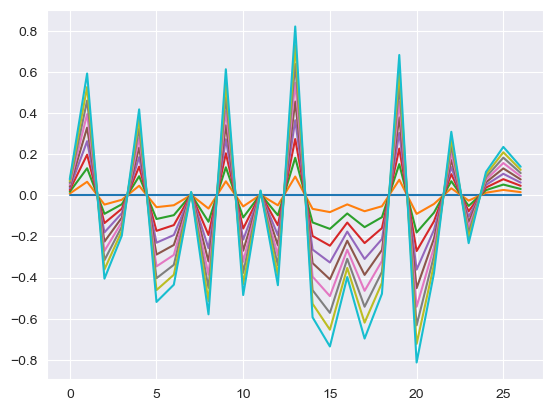

In [298]:
plt.plot(ensemble_list)